In [214]:
from pathlib import Path
from os import listdir
import plotly.figure_factory as ff
import pandas as pd
import random
from IPython.display import Audio

# Music Net

In [107]:
instruments = [
    "Piano",
    "Violin",
    "Cello",
    "Viola",
    "Clarinet",
    "Bassoon",
    "Horn",
    "Oboe",
    "Flute",
    "Bass",
    "Harpsichord"
]

In [68]:
dp = Path("/home/zach/Data/musicnet")

In [168]:
meta = pd.read_csv(dp/"musicnet_metadata.csv")

In [69]:
fs = listdir(dp/"train_labels")

In [255]:
def plot_df_midi(dataframe, instruments, title="unknown file"):
    df = dataframe.copy(deep=True)
    df.rename({"start_time": "Start", "end_time": "Finish", "note": "Task"}, inplace=True, axis="columns")
    df.Start = pd.to_datetime(df.Start, unit='ms')
    df.Finish = pd.to_datetime(df.Finish, unit='ms')
    df["inst_name"] = [instruments[x%len(instruments)] for x in df.instrument]
    df.sort_values(by='Task', inplace=True)
    display(df.head(100))
    fig = ff.create_gantt(df, 
                          group_tasks=True, 
                          index_col="inst_name", 
                          show_colorbar=True, 
                          title=f'MIDI for {title}')
    return fig

In [250]:
listdir(dp)

['musicnet_metadata.csv',
 'test_data',
 'train_labels',
 'test_labels',
 'train_data']

In [251]:
f = random.choice(fs)
af = dp/"train_data"/(f[:-4]+".wav")
title = meta.composition.loc[meta.id == int(f[:-4])].to_string(index=False)
df = pd.read_csv(dp/"train_labels"/f)

,Start,Finish,instrument,Task,start_beat,end_beat,note_value,inst_name
56,1970-01-01 00:07:41.790,1970-01-01 00:08:17.118,1,32,23.0,0.989583,Quarter,Violin
1,1970-01-01 00:01:30.590,1970-01-01 00:02:08.990,1,36,0.0,0.989583,Quarter,Violin
58,1970-01-01 00:08:17.118,1970-01-01 00:08:35.038,1,36,24.0,0.989583,Quarter,Violin
48,1970-01-01 00:06:50.590,1970-01-01 00:07:08.510,1,39,20.0,0.989583,Quarter,Violin
50,1970-01-01 00:07:08.510,1970-01-01 00:07:25.406,1,39,21.0,0.989583,Quarter,Violin
...,...,...,...,...,...,...,...,...
94,1970-01-01 00:12:11.613,1970-01-01 00:12:41.310,1,72,40.0,1.989583,Half,Violin
34,1970-01-01 00:05:45.054,1970-01-01 00:06:14.238,1,72,16.0,1.989583,Half,Violin
43,1970-01-01 00:06:20.382,1970-01-01 00:06:31.646,1,73,18.5,0.489583,Eighth,Violin
98,1970-01-01 00:12:41.310,1970-01-01 00:12:48.990,1,75,42.0,0.489583,Eighth,Violin


/home/zach/anaconda3_v2/lib/python3.7/site-packages/plotly/figure_factory/_gantt.py:49: FutureWarning:


.ix is deprecated. Please use
.loc for label based indexing or
.iloc for positional indexing

See the documentation here:
http://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#ix-indexer-is-deprecated



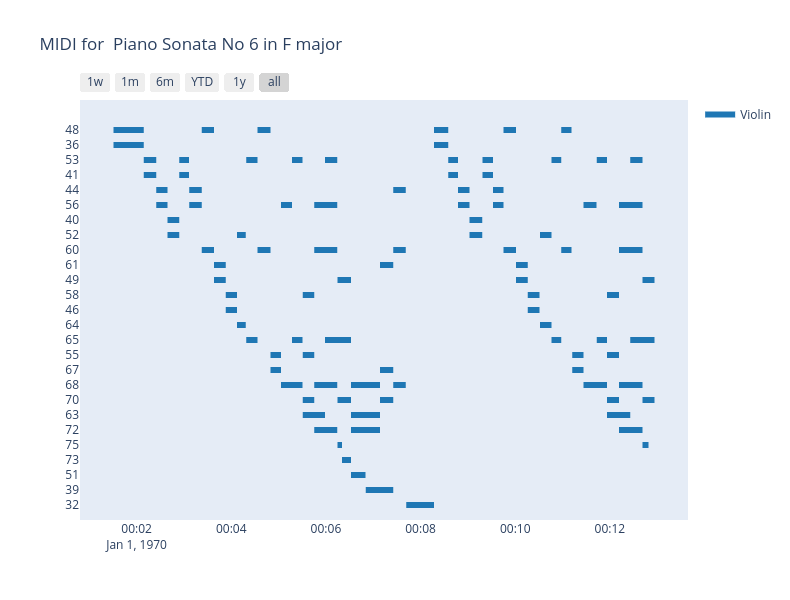

In [256]:
plot_df_midi(df.head(100), instruments, title=title)

In [236]:
Audio(af)